<a href="https://colab.research.google.com/github/avibagchi/pneumonia-detection/blob/main/DeepLearningLab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Lab 3: Deep Learning Lab**

---

**Background**
*   Models "learn" off of **data**. In this lab, our data is made of many images. These images are called **features**.
*   Each feature has a **label** -- pneumonia or normal. 
*   A model needs two types of data -- training data and testing data.
  1. **Training data**: This is the data that builds our model. With every image the model reads, an algorithm is shaped that can hopefully differentiate between a pneumonia and normal X-ray.
  2. **Testing data**: A portion of the initial dataset (usually 10-20%) is not used to build our model. This is our testing data. Our model will predict the label of the testing X-rays. These predictions will be compared to the known label to assess **accuracy**. 

Note: *The reason we do not use the testing data to build our model is because we want to see if our model works for an image it hasn't already "studied."*

First, we need to prepare our data by unzipping our file into its component training and test data for both the NORMAL and PNEUMONIA labels

In [ ]:
#unzips chestxray.zip into:
  # --chestxray
         #--test
              #--NORMAL
              #--PNEUMONIA
         #--train
              #--NORMAL
              #--PNEUMONIA

!unzip chestxray.zip

Archive:  chestxray.zip
  inflating: chestxray/test/NORMAL/IM-0010-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0011-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0016-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0013-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0011-0001-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0017-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0011-0001-0002.jpeg  
  inflating: chestxray/test/NORMAL/IM-0009-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0021-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0019-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0025-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0027-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0029-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0030-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0031-0001.jpeg  
  inflating: chestxray/test/NORMAL/IM-0033-0001-0002.jpeg  
  inflating: chestxray/test/NORMAL/IM-0033-0001-0001.jpeg  
  inflating: chestxra

How much training and testing data do we have for each label? As you will see, we have more NORMAL than PNEUMONIA X-rays as training data. This is called **class imbalance**, and our model will be biased twoards predicting a NORMAL label. 

[0.15 1.15 2.15 3.15]


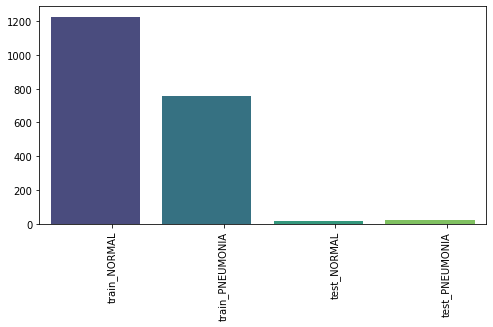

In [ ]:
#displays amount of training and testing data for each label
import os
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns

train_NORMAL_path = "/content/chestxray/train/NORMAL/"
train_PNEUMONIA_path = "/content/chestxray/train/PNEUMONIA/"
test_NORMAL_path = "/content/chestxray/test/NORMAL/"
test_PNEUMONIA_path = "/content/chestxray/test/PNEUMONIA/"

train_NORMAL_data = os.listdir (train_NORMAL_path)
train_PNEUMONIA_data = os.listdir (train_PNEUMONIA_path)
test_NORMAL_data = os.listdir (test_NORMAL_path)
test_PNEUMONIA_data = os.listdir (test_PNEUMONIA_path)

index = np.arange(4) + 0.15
print (index)
labels_bar = ['train_NORMAL', 'train_PNEUMONIA', 'test_NORMAL', 'test_PNEUMONIA']

fig=plt.figure(figsize=(8, 4))
sns.barplot(x=index, y=[len(train_NORMAL_data), len(train_PNEUMONIA_data), len(test_NORMAL_data), len(test_PNEUMONIA_data)], palette="viridis")
plt.xticks(index, labels_bar, rotation='vertical')
plt.show()  

How will our model differentiate between a NORMAL AND PNEUMONIA X-ray? Analyze the differences between the two X-rays.

Let's view 10 x-rays. Press 0 for NORMAL, 1 for PNEUMONIA: 0


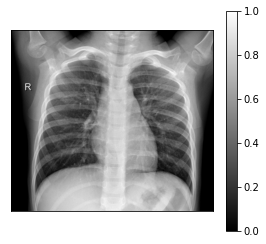

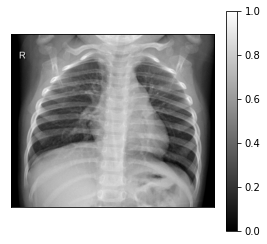

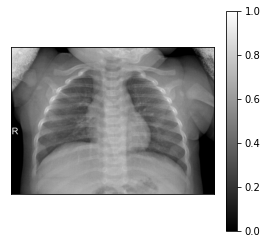

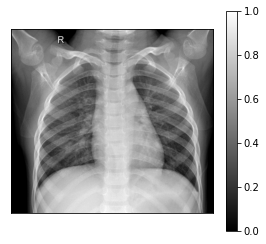

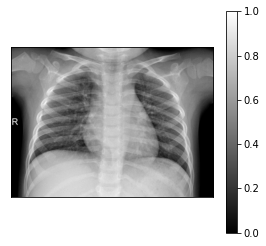

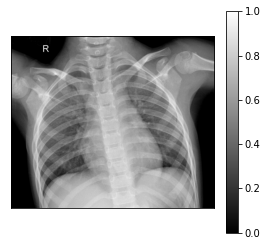

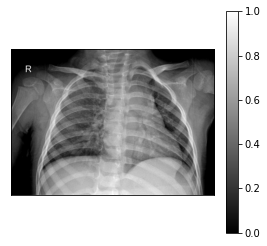

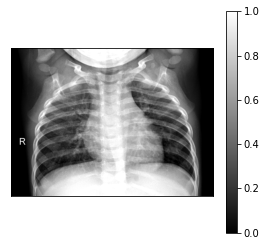

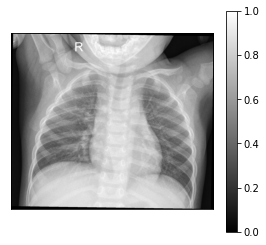

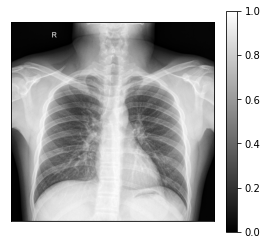

In [ ]:
#view X-rays
import random 
from PIL import Image

def display (s,x):
  count = 1
  
  for i, img in enumerate(s):
    if x == "0":
      sample = os.path.join(train_NORMAL_path, img)
    elif x== "1":
      sample = os.path.join(train_PNEUMONIA_path, img)
    
    fig = plt.figure(figsize=(15, 10))
    npics= 10
    sample_img = Image.open(sample)   
    sample_img = np.array(sample_img)
    sample_img = sample_img/255.0
    ax = fig.add_subplot(int(npics/3) , 4, count, xticks=[],yticks=[])   
    plt.imshow(sample_img, cmap='gray')
    plt.colorbar()
    count +=1
    
    
    if x==0:
      fig.suptitle('Normal X-Rays')
    if x==1:
      fig.suptitle('PNEUMONIA X-Rays')

    plt.tight_layout()
    plt.show()

x = input ("Let's view 10 x-rays. Press 0 for NORMAL, 1 for PNEUMONIA: ")
if x == "0": 
  display (random.sample(train_NORMAL_data, 10), x)
if x=="1": 
  display (random.sample(train_PNEUMONIA_data, 10), x)

Now it is time to build our model with TensorFlow (see comments)

A Convolutional Neural Network (CNN)is a deep learning algorithm typcially used for detecting patterns in images. The convolutional layers in the network have filters which detect patterns in the inputted image. One epoch is when the training data passes through and back through the network once. To better understand how these processes work under the hood, we can use the tf-explain library in conjunction with TensorBoard. 

In [ ]:
!pip install tf-explain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 43 kB 2.1 MB/s 


In [ ]:
import os 
import cv2
import numpy as np
training_x = []
training_y = []
validation_x = []
validation_y = []

fold1="/content/chestxray/train/NORMAL/"
for filename in os.listdir(fold1):
    if filename.endswith(".jpeg"): 
        image = cv2.imread (fold1+filename, cv2.IMREAD_GRAYSCALE)
        image = cv2.resize(image, (200, 200))
        training_x.append (image)
        training_y.append (0)

fold2="/content/chestxray/train/PNEUMONIA/"
for filename in os.listdir(fold2):
    if filename.endswith(".jpeg"): 
        image = cv2.imread (fold2+filename, cv2.IMREAD_GRAYSCALE)
        image = cv2.resize(image, (200, 200))
        training_x.append (image)
        training_y.append (1)

fold3="/content/chestxray/test/NORMAL/"
for filename in os.listdir(fold3):
    if filename.endswith(".jpeg"): 
        image = cv2.imread (fold3+filename, cv2.IMREAD_GRAYSCALE)
        image = cv2.resize(image, (200, 200))
        validation_x.append (image)
        validation_y.append (0)

fold4="/content/chestxray/test/PNEUMONIA/"
for filename in os.listdir(fold4):
    if filename.endswith(".jpeg"): 
        image = cv2.imread (fold4+filename, cv2.IMREAD_GRAYSCALE)
        image = cv2.resize(image, (200, 200))
        validation_x.append (image)
        validation_y.append (1)


In [ ]:
training_x = np.array (training_x)

training_y = np.array (training_y)
training_y = np.asarray(training_y).astype(np.float32)

validation_x = np.array (validation_x)

validation_y = np.array (validation_y)
validation_y  = np.asarray(validation_y).astype(np.float32)

In [ ]:
#Creating the convolutional base
import tensorflow as tf
from tensorflow import keras
from keras import optimizers
from tf_explain.callbacks.activations_visualization import ActivationsVisualizationCallback
import numpy as np

model=tf.keras.models.Sequential([tf.keras.layers.Conv2D(16,(3,3),activation = 'relu', #convolution layer
                                                         input_shape= (200,200, 1)),
                                                         tf.keras.layers.MaxPool2D (2,2),
                                  
                                  tf.keras.layers.Conv2D (32,(3,3),activation='relu'), 
                                  tf.keras.layers.MaxPool2D (2,2),
                                  
                                  tf.keras.layers.Conv2D (64,(3,3),activation='relu'),
                                  tf.keras.layers.MaxPool2D (2,2),

                                  tf.keras.layers.Flatten (),

                                  tf.keras.layers.Dense (512, activation='relu'),
                                  tf.keras.layers.Dense (1,activation ='sigmoid')
                                  
                                  ])
print (model.summary ())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 198, 198, 16)      160       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 99, 99, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 97, 97, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 48, 48, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 46, 46, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 23, 23, 64)       0

In [ ]:
#Layers in the model
names = []
for layer in model.layers:
    names.append (layer.name)
print (names)

['conv2d', 'max_pooling2d', 'conv2d_1', 'max_pooling2d_1', 'conv2d_2', 'max_pooling2d_2', 'flatten', 'dense', 'dense_1']


In [ ]:
#Load TensorBoard
%load_ext tensorboard
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
#Train and evaluate the model with tf-explain callbacks
import datetime
import tf_explain
from tf_explain.callbacks.grad_cam import GradCAMCallback

for x in names:
  print (x)
layer_name = input ("\nType in the layer that you want to analyze from the list above: \n")

epochs = int (input ("How many epochs would you like to train your model with?"))
batch_size = int (input ("How large do you want your batch size?"))
class_index = int (input ("What class index (0 or 1) would you like to analyze: "))

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

callbacks = [
  
  tf_explain.callbacks.GradCAMCallback (validation_data= (validation_x, validation_y), class_index = class_index, layer_name=layer_name, output_dir=log_dir),
  
  tf_explain.callbacks.ActivationsVisualizationCallback(validation_data= (validation_x, validation_y), layers_name=[layer_name], output_dir=log_dir),

  tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1, write_graph=True, write_images=True),
  

                                                 #These callbacks below only work for RGB images. We are using grayscale. 

  #tf_explain.callbacks.SmoothGradCallback(validation_data= (validation_x, validation_y), class_index = class_index, num_samples = 20, noise = 1.0, output_dir="/content"),

  #tf_explain.callbacks.IntegratedGradientsCallback(validation_data= (validation_x, validation_y), class_index = class_index, n_steps = 10, output_dir="/content"),

  #tf_explain.callbacks.VanillaGradientsCallback(validation_data= (validation_x, validation_y), class_index = class_index, output_dir="/content"),
  
  #tf_explain.callbacks.GradientsInputsCallback(validation_data= (validation_x, validation_y), class_index = class_index, output_dir="/content"),
  
  
]



model.compile (loss='binary_crossentropy',
               optimizer=keras.optimizers.RMSprop(lr=0.001),
               metrics=['accuracy'])


model_fit=model.fit(training_x, training_y, batch_size = batch_size, epochs= epochs,
                    callbacks = callbacks)

conv2d
max_pooling2d
conv2d_1
max_pooling2d_1
conv2d_2
max_pooling2d_2
flatten
dense
dense_1

Type in the layer that you want to analyze from the list above: 
conv2d
How many epochs would you like to train your model with?1
How large do you want your batch size?200
What class index (0 or 1) would you like to analyze: 0


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


10/10 [==============================] - ETA: 0s - loss: 4.8540 - accuracy: 0.8902

/usr/local/lib/python3.7/dist-packages/tf_explain/utils/display.py:112: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (heatmap - np.min(heatmap)) / (heatmap.max() - heatmap.min())


10/10 [==============================] - 58s 6s/step - loss: 4.8540 - accuracy: 0.8902


In [ ]:
#Reload the TensorBoard to visualize results
#Go to the "Images" tab to view the callbacks
%reload_ext tensorboard
%tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 1502), started 0:56:45 ago. (Use '!kill 1502' to kill it.)

<IPython.core.display.Javascript object>

Our model now can predict whether a lung X-ray is normal or has pneumonia for any input image. 

Now it is time to make a prediction. Upload an X-ray image to content...
Enter the name of your file (ie. picture.jpeg): IM-0009-0001.jpeg


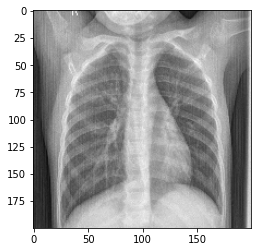

[[0.47332767]]
The lungs are healthy


In [ ]:
from tensorflow.keras.preprocessing import image
import sys

print ("Now it is time to make a prediction. Upload an X-ray image to content...")

try:
  filename=input ("Enter the name of your file (ie. picture.jpeg): ")
  img = image.load_img('/content/'+filename, target_size=(200,200))
except:
  sys.exit("This file does not exist. Make sure you uploaded it to the colab files")
  
plt.imshow(img)
plt.show ()
X=image.img_to_array (img)
X=np.expand_dims(X,axis=0)
images=np.vstack([X])
val=model.predict (tf.image.rgb_to_grayscale(images)) #model was trained on grayscale, so input must be converted to grayscale
print (val)
if round (val[0][0]) == 0:
  print ("The lungs are healthy")
elif round (val[0][0]) == 1:
  print ("The lungs have pneumonia")

References: 

https://www.tensorflow.org/tutorials/images/cnn 

https://tf-explain.readthedocs.io/en/latest/index.html

https://towardsdatascience.com/chest-x-rays-pneumonia-detection-using-convolutional-neural-network-63d6ec2d1dee  

**DELETED CODE (DO NOT USE)**

In [ ]:
#For some of the callbacks in tf-explain, there is a class_index paramter, so it will be useful to seperate our validation data based on class
#validation_x_class0 = []
#validation_x_class1 = []
#validation_y_class0 = []
#validation_y_class1 = []

#validation_x_class0 = validation_x [:18]
#validation_y_class0 = validation_y [:18]
#validation_x_class1 = validation_x [-23:]
#validation_y_class1 = validation_y [-23:]

In [ ]:
#import tensorflow as tf
#from keras_preprocessing.image.image_data_generator import ImageDataGenerator
#import cv2

#Normalizes the pixel values so each image is analyzed the same way
#train = ImageDataGenerator (rescale = 1/255)
#validation = ImageDataGenerator (rescale = 1/255)

#train_dataset = train.flow_from_directory ('/content/chestxray/train/', #training data
                                           #target_size = (200,200), #size of the image
                                           #batch_size = 3, #number of samples passed through the network
                                           #class_mode = 'binary', #binary classification since there are two options: 1. NORMAL, 2. PNEUMONIA
                                           #color_mode='grayscale') #color isn't important in detecting pneumonia in an x-ray, so we can make our images grayscale rather than RGB

#validation_dataset = validation.flow_from_directory ('/content/chestxray/test/', #testing data
                                                     #target_size=(200,200), 
                                                     #batch_size=3,
                                                     #class_mode='binary',
                                                     #color_mode='grayscale')


Found 1986 images belonging to 2 classes.
Found 41 images belonging to 2 classes.


In [ ]:
#validation_x_class0 = []
#validation_x_class1 = []
#validation_y_class0 = []
#validation_y_class1 = []

#print (validation_x)
#print (validation_y)

#for n in range (len (validation_y)):
  #if validation_y [n] == 0:
    #validation_x_class0.append (validation_x [n])
    #validation_y_class0.append (0)
  #elif validation_y [n] == 1:
    #validation_x_class1.append (validation_x [n])
    #validation_y_class0.append (1)



In [ ]:
#from PIL import Image
  
# get image
#filepath = "/content/chestxray/test/NORMAL/IM-0009-0001.jpeg"
#img = Image.open(filepath)
  
# get width and height
#width = img.width
#height = img.height
  
# display width and height
#print("The height of the image is: ", height)
#print("The width of the image is: ", width)

The height of the image is:  1443
The width of the image is:  1852


In [ ]:
#from tensorflow import keras
#from keras import optimizers
#from tf_explain.callbacks.activations_visualization import ActivationsVisualizationCallback

#model=tf.keras.models.Sequential([tf.keras.layers.Conv2D(16,(3,3),activation = 'relu', #convolution layer
                                                         #input_shape= (200,200,1)),
                                                         #tf.keras.layers.MaxPool2D (2,2),
                                  
                                  #tf.keras.layers.Conv2D (32,(3,3),activation='relu'), 
                                  #tf.keras.layers.MaxPool2D (2,2),
                                  
                                  #tf.keras.layers.Conv2D (64,(3,3),activation='relu'),
                                  #tf.keras.layers.MaxPool2D (2,2),

                                  #tf.keras.layers.Flatten (),

                                  #tf.keras.layers.Dense (512, activation='relu'),
                                  #tf.keras.layers.Dense (1,activation ='sigmoid')
                                  
                                  #])


#val_x, val_y = validation_dataset.classes, validation_dataset.class_labels
#callbacks = [ActivationsVisualizationCallback(validation_data=(val_x, val_y), layers_name=["conv2d_30"], output_dir="/content",),]

#model.compile (loss='binary_crossentropy',
               #optimizer=keras.optimizers.RMSprop(lr=0.001),
               #metrics=['accuracy'])


#model_fit=model.fit(train_dataset,
                    #steps_per_epoch = 3,
                    #epochs = 20,
                    #validation_data=validation_dataset
                    #)


#print (model.summary ())

#callbacks=callbacks

Epoch 1/20


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


3/3 [==============================] - 5s 1s/step - loss: 4.6466 - accuracy: 0.5556 - val_loss: 1.8591 - val_accuracy: 0.4390
Epoch 2/20
3/3 [==============================] - 3s 1s/step - loss: 0.9813 - accuracy: 0.4444 - val_loss: 0.7013 - val_accuracy: 0.4390
Epoch 3/20
3/3 [==============================] - 3s 1s/step - loss: 0.8387 - accuracy: 0.7778 - val_loss: 0.7116 - val_accuracy: 0.4390
Epoch 4/20
3/3 [==============================] - 3s 994ms/step - loss: 0.6204 - accuracy: 0.6667 - val_loss: 0.9573 - val_accuracy: 0.4390
Epoch 5/20
3/3 [==============================] - 3s 1s/step - loss: 0.7056 - accuracy: 0.6667 - val_loss: 0.7017 - val_accuracy: 0.4390
Epoch 6/20
3/3 [==============================] - 3s 1s/step - loss: 0.6767 - accuracy: 0.5556 - val_loss: 0.7075 - val_accuracy: 0.4390
Epoch 7/20
3/3 [==============================] - 2s 984ms/step - loss: 0.7092 - accuracy: 0.5556 - val_loss: 0.7144 - val_accuracy: 0.4390
Epoch 8/20
3/3 [==============================

AttributeError: ignored

In [ ]:
#callbacks = [ActivationsVisualizationCallback(validation_data=(validation_x, validation_y), 
                                              #layers_name=[layer_name], output_dir="/content",), 
                                              #tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)]